In [1]:
!pip install konlpy

Defaulting to user installation because normal site-packages is not writeable


In [2]:
!ls -l ./naverRatings.zip

-rw-r--r-- 1 lab11 multi 7903524 Apr 21 10:17 ./naverRatings.zip


In [3]:
!unzip ./naverRatings.zip

Archive:  ./naverRatings.zip
  inflating: naverRatings.txt        


In [4]:
import pandas as pd
import matplotlib.pyplot as plt

train_data = pd.read_table('naverRatings.txt')
train_data[:5]

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요ㅋㅋ,1
1,8132799,"디자인을 배우는 학생으로, 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산...",1
2,4655635,폴리스스토리 시리즈는 1부터 뉴까지 버릴께 하나도 없음.. 최고.,1
3,9251303,와.. 연기가 진짜 개쩔구나.. 지루할거라고 생각했는데 몰입해서 봤다.. 그래 이런...,1
4,10067386,안개 자욱한 밤하늘에 떠 있는 초승달 같은 영화.,1


In [5]:
print(len(train_data), type(train_data))


200000 <class 'pandas.core.frame.DataFrame'>


In [8]:
print(train_data.isnull().values.any())
print(train_data.isnull().values)

True
[[False False False]
 [False False False]
 [False False False]
 ...
 [False False False]
 [False False False]
 [False False False]]


In [10]:
train_data = train_data.dropna(how='any')
print(train_data.isnull().values.any())

False


In [11]:
print(len(train_data))

199992


In [12]:
train_data['document'] = train_data['document'].str.replace('[^ㄱ-ㅎㅏ-ㅣ가-힣 ]', '')

In [13]:
train_data[:5]

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요ㅋㅋ,1
1,8132799,디자인을 배우는 학생으로 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산업...,1
2,4655635,폴리스스토리 시리즈는 부터 뉴까지 버릴께 하나도 없음 최고,1
3,9251303,와 연기가 진짜 개쩔구나 지루할거라고 생각했는데 몰입해서 봤다 그래 이런게 진짜 영화지,1
4,10067386,안개 자욱한 밤하늘에 떠 있는 초승달 같은 영화,1


In [14]:
train_data['document'].shape

(199992,)

In [15]:
stopwords = ['의','가','이','은','들','는','좀','잘','걍','과','도','를','으로','자','에','와','한','하다']

In [19]:
%%time

from konlpy.tag import Okt

okt = Okt()
tokenized_data =[]

for sentence in train_data['document']:
    temp_X = okt.morphs(sentence, stem=True)
    print(temp_X)
    temp_X = [word for word in temp_X if not word in stopwords]
    tokenized_data.append(temp_X)
    

['어리다', '때', '보고', '지금', '다시', '보다', '재밌다', 'ㅋㅋ']
['디자인', '을', '배우다', '학생', '으로', '외국', '디자이너', '와', '그', '들', '이', '일군', '전통', '을', '통해', '발전', '하다', '문화', '산업', '이', '부럽다', '사실', '우리나라', '에서도', '그', '어렵다', '시절', '에', '끝', '까지', '열정', '을', '지키다', '노라노', '같다', '전통', '이', '있다', '저', '와', '같다', '사람', '들', '이', '꿈', '을', '꾸다', '이루다', '나가다', '수', '있다', '것', '에', '감사하다']
['폴리스스토리', '시리즈', '는', '부터', '뉴', '까지', '버리다', '하나', '도', '없다', '최고']
['오다', '연기', '가', '진짜', '개', '쩔다', '지루하다', '생각', '하다', '몰입', '하다', '보다', '그렇다', '이렇다', '진짜', '영화', '지']
['안개', '자욱하다', '밤하늘', '에', '뜨다', '있다', '초승달', '같다', '영화']
['사랑', '을', '해보다', '사람', '이', '라면', '처음', '부터', '끝', '까지', '웃다', '있다', '영화']
['완전', '감동', '이다', '다시', '보다', '감동']
['개', '들', '의', '전쟁', '나오다', '나오다', '빠', '로', '보고', '싶다']
['굿']
['바보', '가', '아니다', '병', '쉰', '이다']
['내', '나이', '와', '같다', '영화', '를', '지금', '보다', '나', '는', '감동', '적', '이다', '하지만', '훗날', '다시', '보다', '사하나', '하', '나', '그', '감정', '을', '완벽하다', '이해', '하다', '같다']
['재밌다']
['고질', '라니', '무', '귀엽

In [20]:
len(tokenized_data)

199992

In [21]:
tokenized_data[:5]

[['어리다', '때', '보고', '지금', '다시', '보다', '재밌다', 'ㅋㅋ'],
 ['디자인',
  '을',
  '배우다',
  '학생',
  '외국',
  '디자이너',
  '그',
  '일군',
  '전통',
  '을',
  '통해',
  '발전',
  '문화',
  '산업',
  '부럽다',
  '사실',
  '우리나라',
  '에서도',
  '그',
  '어렵다',
  '시절',
  '끝',
  '까지',
  '열정',
  '을',
  '지키다',
  '노라노',
  '같다',
  '전통',
  '있다',
  '저',
  '같다',
  '사람',
  '꿈',
  '을',
  '꾸다',
  '이루다',
  '나가다',
  '수',
  '있다',
  '것',
  '감사하다'],
 ['폴리스스토리', '시리즈', '부터', '뉴', '까지', '버리다', '하나', '없다', '최고'],
 ['오다',
  '연기',
  '진짜',
  '개',
  '쩔다',
  '지루하다',
  '생각',
  '몰입',
  '보다',
  '그렇다',
  '이렇다',
  '진짜',
  '영화',
  '지'],
 ['안개', '자욱하다', '밤하늘', '뜨다', '있다', '초승달', '같다', '영화']]

In [28]:
print('리뷰의 최대 길이:', max(len(i) for i in tokenized_data))
print('리뷰의 평균 길이:', sum(map(len, tokenized_data))/len(tokenized_data))
#print('리뷰의 평균 길이:', sum(len(tokenized_data))/len(tokenized_data))
print('리뷰의 최소 길이:', min(len(i) for i in tokenized_data))

리뷰의 최대 길이: 72
리뷰의 평균 길이: 10.716703668146726
리뷰의 최소 길이: 0


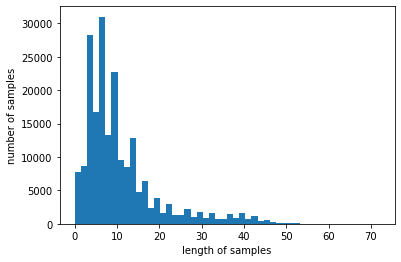

In [24]:
plt.hist([len(s) for s in tokenized_data], bins=50)
plt.xlabel('length of samples')
plt.ylabel('number of samples')
plt.show()

In [39]:
from gensim.models import Word2Vec

model = Word2Vec(sentences = tokenized_data, window = 5,min_count = 5,workers = 4,sg = 1)
model.wv.vectors.shape

(16477, 100)

In [41]:
model.wv.most_similar('이병헌')

[('최수종', 0.8046470880508423),
 ('안성기', 0.8036641478538513),
 ('김승우', 0.7921870350837708),
 ('양동근', 0.7913783192634583),
 ('공리', 0.7899212837219238),
 ('정려원', 0.7893455028533936),
 ('혼신', 0.7870452404022217),
 ('유다인', 0.7869523763656616),
 ('숀펜', 0.7863240838050842),
 ('김명민', 0.786323606967926)]

In [42]:
model.wv.most_similar('연애')

[('동거', 0.6391289234161377),
 ('결혼', 0.6390752196311951),
 ('백야', 0.6389395594596863),
 ('이혼', 0.6379784941673279),
 ('권태기', 0.6350721716880798),
 ('주부', 0.6299499869346619),
 ('말좀', 0.6287172436714172),
 ('친딸', 0.6279895305633545),
 ('응급남녀', 0.6240895390510559),
 ('패륜', 0.6235644817352295)]